# Import python dataset

In [1]:
allow_pickle=True

In [2]:
notebookName = 'DCGAN.ipynb'

In [3]:
k = 823

In [4]:
# Python ≥3.5 is required
import sys
assert sys.version_info >= (3, 5)

# Scikit-Learn ≥0.20 is required
import sklearn
assert sklearn.__version__ >= "0.20"

# TensorFlow ≥2.0 is required
import tensorflow as tf
from tensorflow import keras
assert tf.__version__ >= "2.0"

# Common imports
import numpy as np
import os

# To plot pretty figures
%matplotlib inline
import matplotlib as mpl
import matplotlib.pyplot as plt
mpl.rc('axes', labelsize=14)
mpl.rc('xtick', labelsize=12)
mpl.rc('ytick', labelsize=12)

import pandas as pd
import time

In [5]:
import numpy as np
import functools
import time

import matplotlib.pyplot as plt
import tensorflow as tf
import keras
from keras.optimizers import Adam
from tensorflow import reduce_mean
import gc
from sklearn.preprocessing import *
import joblib
import matplotlib.ticker as mticker



In [20]:
from keras.datasets import mnist
from keras.layers import Input, Dense, Reshape, Flatten, Dropout
from keras.layers import BatchNormalization, Activation, ZeroPadding2D
from keras.layers.advanced_activations import LeakyReLU
from keras.layers.convolutional import UpSampling2D, Conv2D
from keras.models import Sequential, Model
from keras.optimizers import Adam

In [8]:
tf.config.run_functions_eagerly(True)

## Load data

In [10]:
n_features = 7

In [11]:
data= np.loadtxt('input/pollutant/01.txt') 
print(data.shape)

data02= np.loadtxt('input/pollutant/02.txt') 
print(data02.shape)

data04= np.loadtxt('input/pollutant/04.txt') 
print(data04.shape)


groups = ['PM10','PM2_5', 'PM1', 'CO2' ,'Temeprature' ,'RH']
groups = np.array(groups)
print(groups.shape)

groups2 = ['times','PM10','PM2_5', 'PM1', 'CO2' ,'Temeprature' ,'RH']
groups2 = np.array(groups2)
print(groups.shape)

(1419, 7)
(1419, 7)
(1419, 7)
(6,)
(6,)


In [12]:
with open("input/pollutant/10_2_time.csv", "r", encoding="utf-8") as fr:
    times = [fr.readlines()]
    
times = np.array(times)
times = times.T
print(times[:,0].shape)


(1419,)


<function matplotlib.pyplot.show(close=None, block=None)>

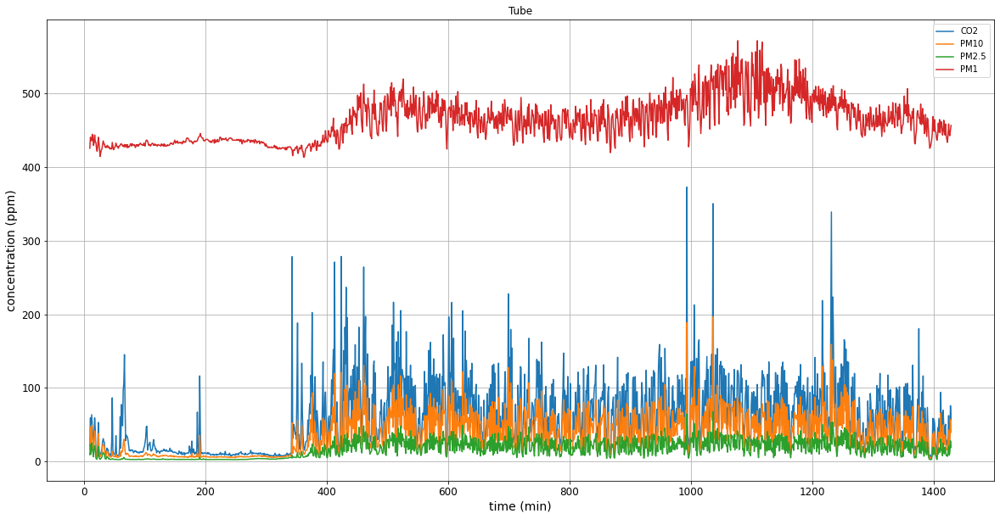

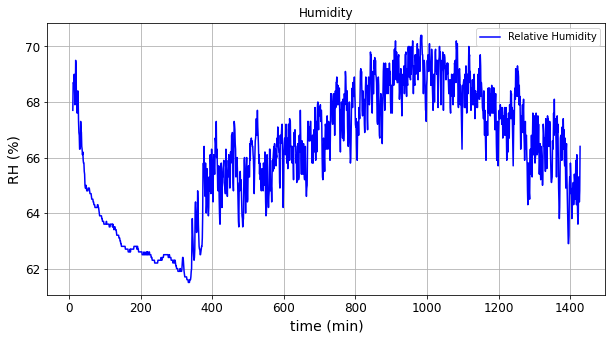

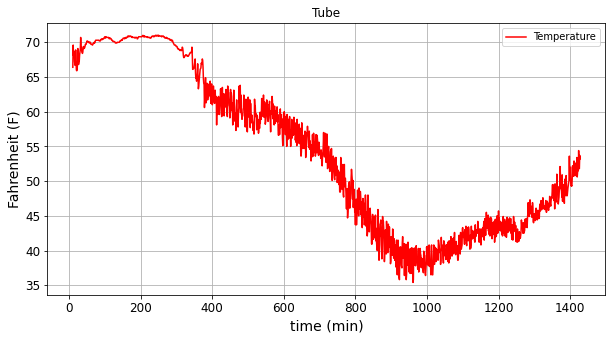

In [13]:
fig, ax = plt.subplots(1,1, figsize=[20,10])
ax.plot(data[:,0], data[:,1], label='CO2')
ax.plot(data[:,0], data[:,2], label='PM10')
ax.plot(data[:,0], data[:,3], label='PM2.5')
ax.plot(data[:,0], data[:,4], label='PM1')

ax.grid()
plt.ylabel("concentration (ppm)")
plt.xlabel("time (min)")
plt.title('Tube')
plt.legend()
plt.savefig('./output/Figures/Sample'+'CO2+PM_v'+str(k)+'.png')

fig, ax = plt.subplots(1,1, figsize=[10,5])
ax.plot(data[:,0], data[:,5],c='blue', label='Relative Humidity')
ax.grid()
plt.ylabel("RH (%)")
plt.xlabel("time (min)")
plt.title('Humidity')
plt.legend()
plt.savefig('./output/Figures/Sample'+'RH_v'+str(k)+'.png')

fig, ax = plt.subplots(1,1, figsize=[10,5])
ax.plot(data[:,0], data[:,6],c='red', label='Temperature') #what is the unit?
ax.grid()
plt.ylabel("Fahrenheit (F)")
plt.xlabel("time (min)")
plt.title('Tube')
plt.legend()

plt.savefig('./output/Figures/Sample'+'Temp_v'+str(k)+'.png')
plt.show

# Preparing Dataset

In [14]:
codings_size = n_features

from sklearn.preprocessing import MinMaxScaler
scaler = MinMaxScaler(feature_range=[-1,1])
X_train_scaled = scaler.fit_transform(data)

X_train_scaled.shape 


(1419, 7)

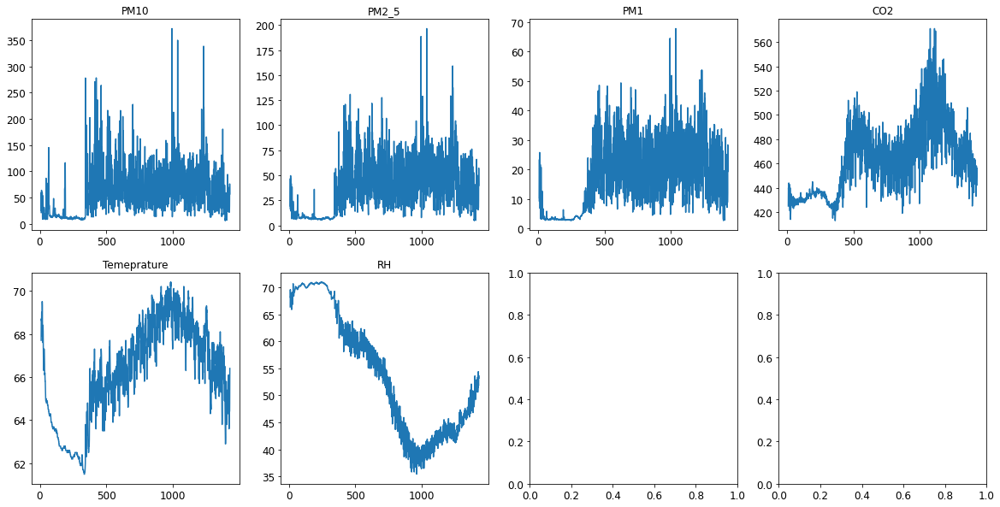

In [16]:
#scaler inverse_transform
X_train = scaler.inverse_transform(((X_train_scaled)))
X_train.shape 

fig, ax = plt.subplots(2,4, figsize=[20,10])
for i, group in enumerate(groups):
    #a=i+1
    ax.flatten()[i].plot(X_train[:,0], X_train[:,i+1])
    ax.flatten()[i].set_title(group)
plt.savefig('./output/Figures/Individual/Sample'+'_v'+str(k)+'.png')

# Train the GAN

### Preparing the training dataset

In [17]:
n = 0

(1319, 100, 7, 1)
(100, 7, 1)


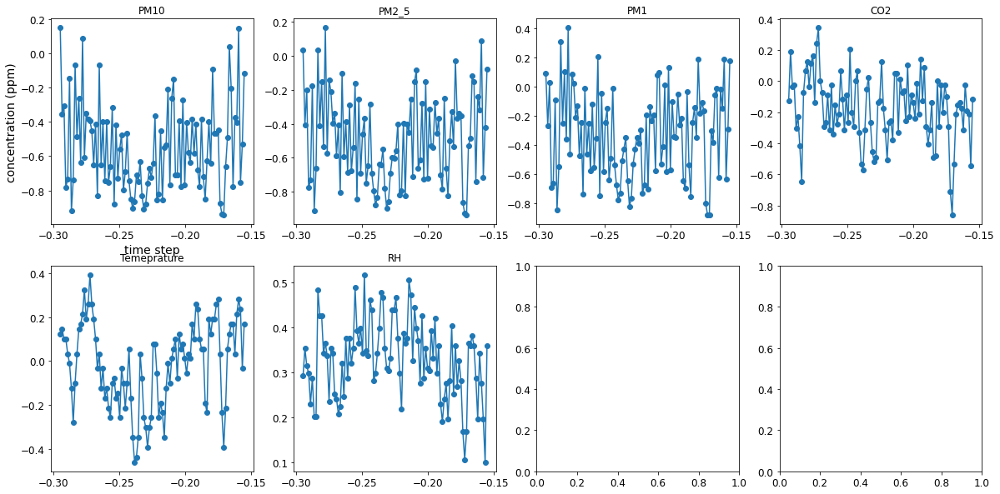

In [18]:
def concat_timesteps(X_train_scaled, ntimes, step):
    X_train_concat = []
    for i in range(len(X_train_scaled) - ntimes*step):
        X_train_concat.append(X_train_scaled[i:i+ntimes*step:step])
    return np.array(X_train_concat)

ntimes = 100 # Consecutive times for the GAN
step = 1 # step between times (1 mins)

X_train_concat = concat_timesteps(X_train_scaled, ntimes, step)#X_train_scaled
X_train_concat = X_train_concat.reshape(X_train_concat.shape[0],ntimes,n_features,1)
print(X_train_concat.shape)
#Individual sample dataset


print(X_train_concat[n].shape)
fig, ax = plt.subplots(2,4, figsize=[20,10])
for i, group in enumerate(groups):
    ax.flatten()[i].plot(X_train_concat[n][:,0,-1], X_train_concat[n][:,i+1,-1], '-o')
    ax.flatten()[i].set_title(group)
    ax.flatten()[0].set_xlabel("time step")
    ax.flatten()[0].set_ylabel("concentration (ppm)")



In [19]:
BATCH_SIZE = 32
latent_space = 100

# Create a tensorflow dataset and split it into batches
train_dataset = X_train_concat.reshape(X_train_concat.shape[0], ntimes, n_features,1).astype('float32')
train_dataset = tf.data.Dataset.from_tensor_slices(train_dataset)
train_dataset = train_dataset.shuffle(len(X_train_scaled))
train_dataset = train_dataset.batch(BATCH_SIZE)

for data in train_dataset:
    print(data.shape)
    break

(32, 100, 7, 1)


# Define Training 

# Formally Training

In [29]:
gan = tf.keras.models.load_model('input/ganmodels/DCGAN_v816_epoch_4000.h5',).layers
generator, discriminator = tf.keras.models.load_model('input/ganmodels/DCGAN_v816_epoch_4000.h5').layers  

# Generated Data

(131900, 7)
save generated image


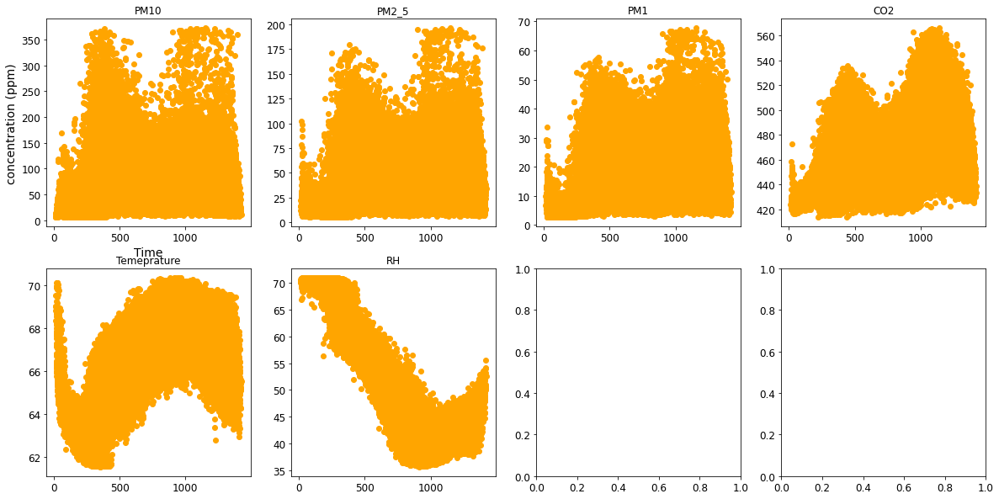

In [30]:
#generated data
n_instances = X_train_concat.shape[0]
noise = tf.random.normal([n_instances, latent_space])
generated_image = generator(noise, training=False)
generated_image = generated_image.numpy()
generated_image = generated_image.reshape(n_instances*ntimes*1, n_features)
generated_image = scaler.inverse_transform(generated_image)


print(generated_image.shape)

fig, ax = plt.subplots(2,4, figsize=[20,10])
for i, group in enumerate(groups):
    ax.flatten()[i].plot(generated_image[:,0],generated_image[:,i+1],'o',c='orange')

        
    ax.flatten()[i].set_title(group)
    ax.flatten()[0].set_xlabel("Time")
    ax.flatten()[0].set_ylabel("concentration (ppm)")
    
plt.savefig('./output/Figures/Result/result+_v'+str(k)+'.png')
print('save generated image')


(131900, 7)


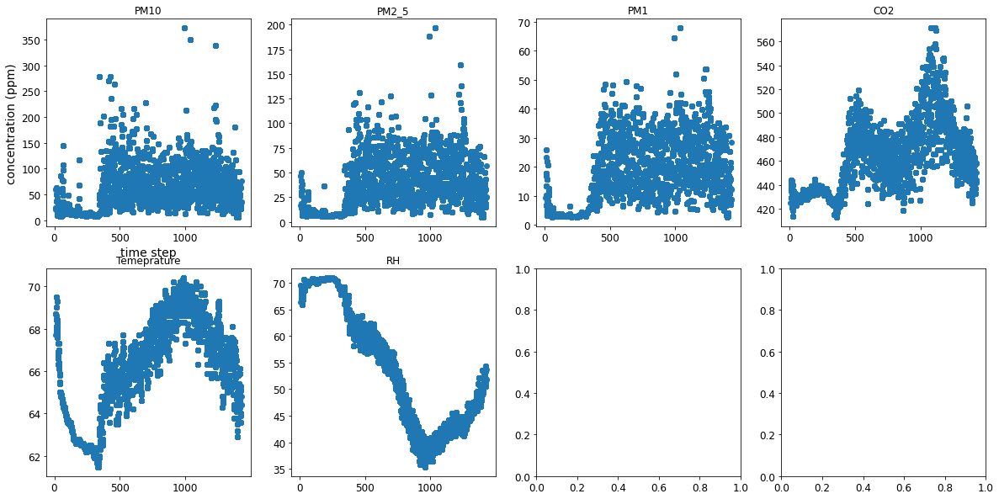

In [31]:
X_train_concat_flatten2 = X_train_concat.reshape(X_train_concat.shape[0]*ntimes, n_features).astype('float32')
X_train_concat_flatten2 = scaler.inverse_transform(X_train_concat_flatten2)
print(X_train_concat_flatten2.shape)

fig, ax = plt.subplots(2,4, figsize=[20,10])
for i, group in enumerate(groups):
    ax.flatten()[i].plot(X_train_concat_flatten2[:,0],X_train_concat_flatten2[:,i+1],'o')

    ax.flatten()[i].set_title(group)
    ax.flatten()[0].set_xlabel("time step")
    ax.flatten()[0].set_ylabel("concentration (ppm)")    
    
plt.savefig('./output/Figures/Result/sample_v'+str(k)+'.png')

# Predict with the GAN

In [34]:
n = 0
epochs = 1000
epochs2 = 1000 
epochs3 = 1000
predict_points = X_train.shape[0]-n-ntimes

In [35]:
mse = tf.keras.losses.MeanSquaredError()
optimizer = tf.keras.optimizers.Adam(2e-2) #1e-4

def mse_loss(inp, outp):
    inp = tf.reshape(inp, [-1, n_features]) 
    outp = tf.reshape(outp, [-1, n_features])
    print("input:",inp.shape)
    print("output:",outp.shape)
    
    return mse(inp, outp)

def optimize_coding(latent_values, real_coding, epochs=epochs):
    
    for epoch in range(epochs):
        opt_step(latent_values, real_coding)
        
    return latent_values  #returns the optimized input that generates the desired output


@tf.function
def opt_step(latent_values, real_coding):
    with tf.GradientTape() as tape:
        tape.watch(latent_values)
        gen_output = generator(latent_values, training=False)  #results from generator
        loss = mse_loss(real_coding, gen_output[-1,:(ntimes - 1),:])   #codings_size is size of each output, ntimes is number of time levels. 
        #If training for 9 time levels, it finds the loss between the first 8 outputs from the generator and 8 real outputs

    gradient = tape.gradient(loss, latent_values)   #gradient of the loss ws to the input
    optimizer.apply_gradients(zip([gradient], [latent_values]))   #applies gradients to the input
    
    return loss

In [ ]:
np.random.seed(0)
tf.random.set_seed(0)

real_coding = X_train_concat[n].reshape(1,-1)
real_coding = real_coding[:,:codings_size*(ntimes - 1)]
real_coding = tf.constant(real_coding)
real_coding = tf.cast(real_coding, dtype=tf.float32)

latent_values = tf.random.normal([len(real_coding), latent_space])  
latent_values = tf.Variable(latent_values)     #make input a tensorflow variable so it can be trained

latent_values = optimize_coding(latent_values, real_coding, epochs=epochs3)
X_predict = list(generator(latent_values).numpy().reshape(-1,n_features))
gen_predict = X_predict[-1]
real_coding = np.concatenate((real_coding, gen_predict.reshape(1,-1)), axis=1)[:,n_features:]
real_coding = tf.constant(real_coding)
real_coding = tf.cast(real_coding, dtype=tf.float32)

for i in range(predict_points): #range(2000,len(X_train_concat)-1):
    latent_values = optimize_coding(latent_values, real_coding, epochs)
    gen_predict = generator(latent_values)[:,(ntimes - 1):,:,:].numpy()
    X_predict.append(gen_predict.flatten())
    real_coding = np.concatenate((real_coding, gen_predict.reshape(1,-1)), axis=1)[:,codings_size:]
    real_coding = tf.constant(real_coding)
    real_coding = tf.cast(real_coding, dtype=tf.float32)
X_predict = np.array(X_predict)

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: 

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: 

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: 

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: 

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: 

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: 

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: 

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: 

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: 

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: 

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: 

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: 

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: 

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: 

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: 

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: 

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: 

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (99, 7)
output: (99, 7)
input: (

In [ ]:
X_generated = scaler.inverse_transform(X_predict)
X_generated = X_generated.reshape(len(X_predict), len(groups2))
X_generated[X_generated<0] = 0 
np.save('X_generatedall.npy',X_generated)

print(X_generated.shape)
print(X_train.shape)

fig, ax = plt.subplots(2,4, figsize=[20,10])
for i, group in enumerate(groups):
    #ax.flatten()[i].plot(X_generated[:,i+1], '-',c='orange', label='generated')
    ax.flatten()[i].plot(X_train[n:(n+ntimes+predict_points),i+1], '-', label='real')
    ax.flatten()[i].plot(X_generated[:,i+1], '-',c='orange', label='generated')
    ax.flatten()[i].set_title(group)
    ax.flatten()[i].legend()
    
plt.savefig('./output/Figures/Prediction/entire'+str(k)+'_epoch_'+str(epoch)+'.png')